In [2]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

In [3]:
im_src = cv2.resize(cv2.imread('phone.jpg'), (1024, 768))
pts_src = []
im_dst = cv2.imread('gmap.png')
pts_dst = []

In [4]:
im_src_copy = im_src
im_dst_copy = im_dst
def select_point(event, x, y, flags, param):
    if event == cv2.EVENT_LBUTTONDOWN:  # On left mouse button click
        if param == 'src':
            pts_src.append((x, y))  # Store clicked coordinates
            cv2.circle(im_src, (x, y), 3, (255, 0, 0), -1)  # Draw a circle at the clicked point
            cv2.imshow('Select Source Points', im_src_copy)  # Update the display
        elif param == 'dst':
            pts_dst.append((x, y))  # Store clicked coordinates
            cv2.circle(im_dst, (x, y), 2, (255, 0, 0), -1)  # Draw a circle at the clicked point
            cv2.imshow('Select Destination Points', im_dst_copy)  # Update the display

# def select_point_gmap(event, x, y, flags, param):
#     if event == cv2.EVENT_LBUTTONDOWN:  # On left mouse button click
        
cv2.imshow('Select Source Points', im_src_copy)  # Show the image in a window
cv2.imshow('Select Destination Points', im_dst_copy)
cv2.setMouseCallback('Select Source Points', select_point, 'src')  # Set the mouse callback function
cv2.setMouseCallback('Select Destination Points', select_point, 'dst')  # Set the mouse callback function

while True:
    key = cv2.waitKey(0)  # Wait for a key press
    if key == 27:  # If 'Esc' key is pressed
        break  # Exit the loop

cv2.destroyAllWindows()
print(pts_src, pts_dst)

[] []


In [5]:
# [(224, 539), (373, 473), (887, 512), (730, 468), (3, 542), (245, 766), (780, 764), (542, 432), (602, 430), (445, 427), (376, 427), (461, 421)] [(299, 523), (297, 462), (337, 509), (334, 470), (277, 526), (309, 544), (320, 542), (320, 311), (337, 310), (292, 284), (258, 283), (298, 224)]

In [6]:
pts_src = np.array([(224, 539), (373, 473), (887, 512), (730, 468), (3, 542), (245, 766), (780, 764), (542, 432), (602, 430), (445, 427), (376, 427), (461, 421)]).reshape(-1,2)
pts_dst = np.array([(299, 523), (297, 462), (337, 509), (334, 470), (277, 526), (309, 544), (320, 542), (320, 311), (337, 310), (292, 284), (258, 283), (298, 224)]).reshape(-1,2)

Text(0.5, 1.0, 'destination coordinates')

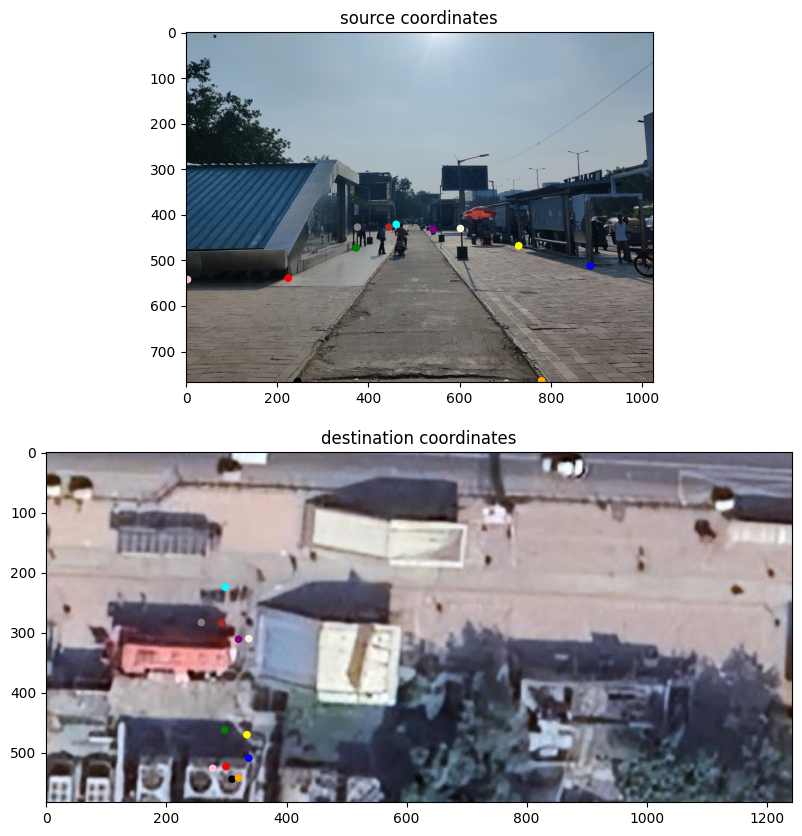

In [7]:
ig, ax = plt.subplots(2, 1, figsize=(25, 10))
color_list = ["red","green","blue","yellow","pink","black","orange","purple","beige","brown","gray","cyan","magenta"]
colors = np.array(color_list[:len(pts_src)])
ax[0].imshow(cv2.cvtColor(im_src, cv2.COLOR_BGR2RGB))
ax[0].scatter(pts_src[:,0], pts_src[:,1], c=colors, s=20)
ax[0].set_title('source coordinates')
ax[1].imshow(cv2.cvtColor(im_dst, cv2.COLOR_BGR2RGB))
ax[1].scatter(pts_dst[:,0], pts_dst[:,1], c=colors, s=20)
ax[1].set_title('destination coordinates')

In [8]:
h, status = cv2.findHomography(pts_src, pts_dst, cv2.RANSAC)

In [9]:
im_out = cv2.warpPerspective(im_src, h, (im_dst.shape[1],im_dst.shape[0]), flags=cv2.INTER_LINEAR)

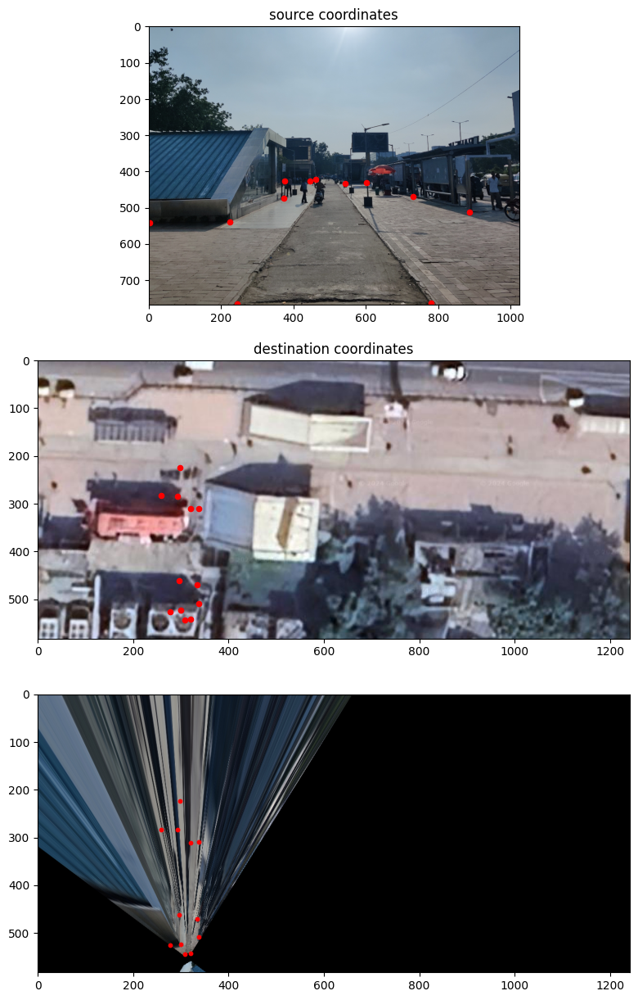

In [10]:
fig, ax = plt.subplots(3, 1, figsize=(25, 15))
ax[0].imshow(cv2.cvtColor(im_src, cv2.COLOR_BGR2RGB))
ax[0].scatter(pts_src[:,0], pts_src[:,1], c='red', s=20)
ax[0].set_title('source coordinates')
ax[1].imshow(cv2.cvtColor(im_dst, cv2.COLOR_BGR2RGB) )
ax[1].scatter(pts_dst[:,0], pts_dst[:,1], c='red', s=20)
ax[1].set_title('destination coordinates')
ax[2].imshow(cv2.cvtColor(im_out, cv2.COLOR_BGR2RGB))
ax[2].scatter(pts_dst[:,0], pts_dst[:,1], c='red', s=10)

In [11]:
im_src = cv2.resize(cv2.imread('pictures/old_image6.jpg'), (1200, 900))
pts_src = []
im_dst = cv2.imread('pictures/gmap.png')
pts_dst = []

In [12]:
im_src_copy = im_src
im_dst_copy = im_dst
def select_point(event, x, y, flags, param):
    if event == cv2.EVENT_LBUTTONDOWN:  # On left mouse button click
        if param == 'src':
            pts_src.append((x, y))  # Store clicked coordinates
            cv2.circle(im_src, (x, y), 3, (255, 0, 0), -1)  # Draw a circle at the clicked point
            cv2.imshow('Select Source Points', im_src_copy)  # Update the display
        elif param == 'dst':
            pts_dst.append((x, y))  # Store clicked coordinates
            cv2.circle(im_dst, (x, y), 2, (255, 0, 0), -1)  # Draw a circle at the clicked point
            cv2.imshow('Select Destination Points', im_dst_copy)  # Update the display

# def select_point_gmap(event, x, y, flags, param):
#     if event == cv2.EVENT_LBUTTONDOWN:  # On left mouse button click

cv2.imshow('Select Source Points', im_src_copy)  # Show the image in a window
cv2.imshow('Select Destination Points', im_dst_copy)
cv2.setMouseCallback('Select Source Points', select_point, 'src')  # Set the mouse callback function
cv2.setMouseCallback('Select Destination Points', select_point, 'dst')  # Set the mouse callback function

while True:
    key = cv2.waitKey(0)  # Wait for a key press
    if key == 27:  # If 'Esc' key is pressed
        break  # Exit the loop

cv2.destroyAllWindows()
print(pts_src, pts_dst)

[] []


[(99, 582), (531, 500), (1020, 501), (790, 473), (715, 488), (948, 555), (430, 516), (745, 479), (856, 483), (884, 499)] [(541, 275), (449, 272), (419, 188), (154, 212), (382, 243), (514, 212), (490, 273), (307, 232), (329, 202), (417, 212)]

[(117, 679), (257, 653), (492, 612), (622, 588), (1111, 648), (1013, 588), (1002, 565), (1196, 583), (1036, 582), (846, 579), (836, 573), (875, 562), (926, 555), (958, 555), (1053, 650), (863, 646), (990, 588), (906, 588), (938, 707)] [(544, 275), (529, 274), (491, 274), (450, 274), (514, 212), (431, 210), (330, 201), (414, 182), (414, 204), (401, 230), (376, 236), (307, 231), (155, 214), (155, 199), (513, 218), (513, 229), (431, 215), (431, 225), (525, 224)]


In [13]:
pts_src = np.array([(117, 679), (257, 653), (492, 612), (622, 588), (1111, 648), (1013, 588), (1002, 565), (1196, 583), (1036, 582), (846, 579), (836, 573), (875, 562), (926, 555), (958, 555), (1053, 650), (863, 646), (990, 588), (906, 588)]).reshape(-1,2)
pts_dst = np.array([(544, 275), (529, 274), (491, 274), (450, 274), (514, 212), (431, 210), (330, 201), (414, 182), (414, 204), (401, 230), (376, 236), (307, 231), (155, 214), (155, 199), (513, 218), (513, 229), (431, 215), (431, 225)]).reshape(-1,2)

Text(0.5, 1.0, 'destination coordinates')

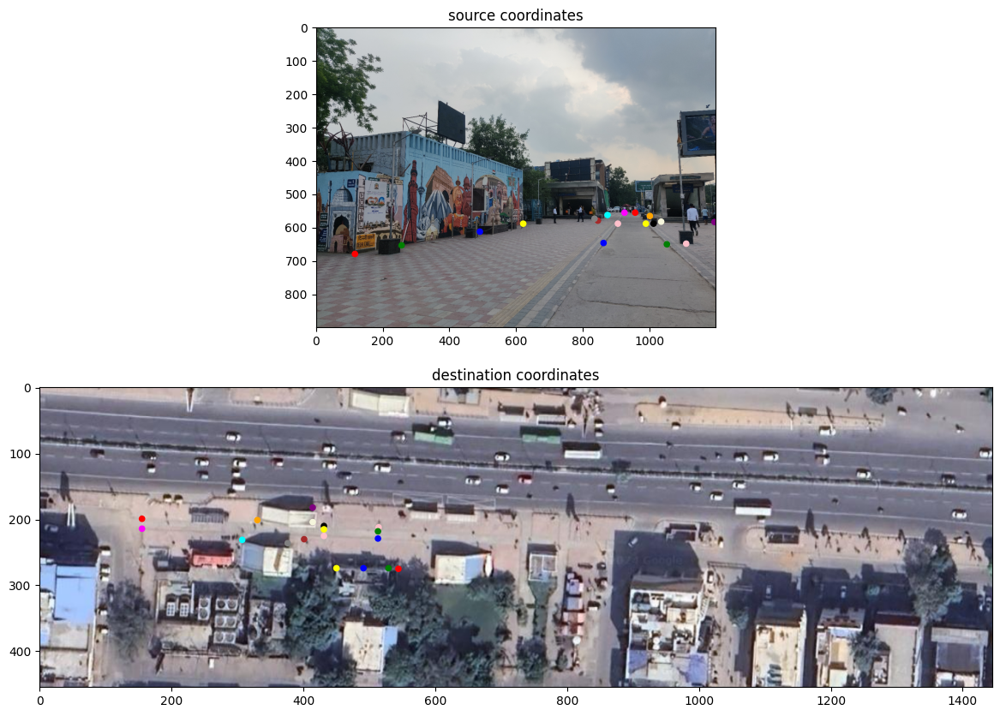

In [14]:
ig, ax = plt.subplots(2, 1, figsize=(25, 10))
color_list = ["red","green","blue","yellow","pink","black","orange","purple","beige","brown","gray","cyan","magenta", "red","green","blue","yellow","pink","black","orange","purple","beige","brown","gray","cyan","magenta"]
colors = np.array(color_list[:len(pts_src)])
ax[0].imshow(cv2.cvtColor(im_src, cv2.COLOR_BGR2RGB))
ax[0].scatter(pts_src[:,0], pts_src[:,1], c=colors, s=20)
ax[0].set_title('source coordinates')
ax[1].imshow(cv2.cvtColor(im_dst, cv2.COLOR_BGR2RGB))
ax[1].scatter(pts_dst[:,0], pts_dst[:,1], c=colors, s=20)
ax[1].set_title('destination coordinates')

In [15]:
h2, status = cv2.findHomography(pts_src, pts_dst)

In [16]:
print(np.sum(status))

18


In [17]:
im_out = cv2.warpPerspective(im_src, h2, (im_dst.shape[1],im_dst.shape[0]), flags=cv2.INTER_LINEAR)

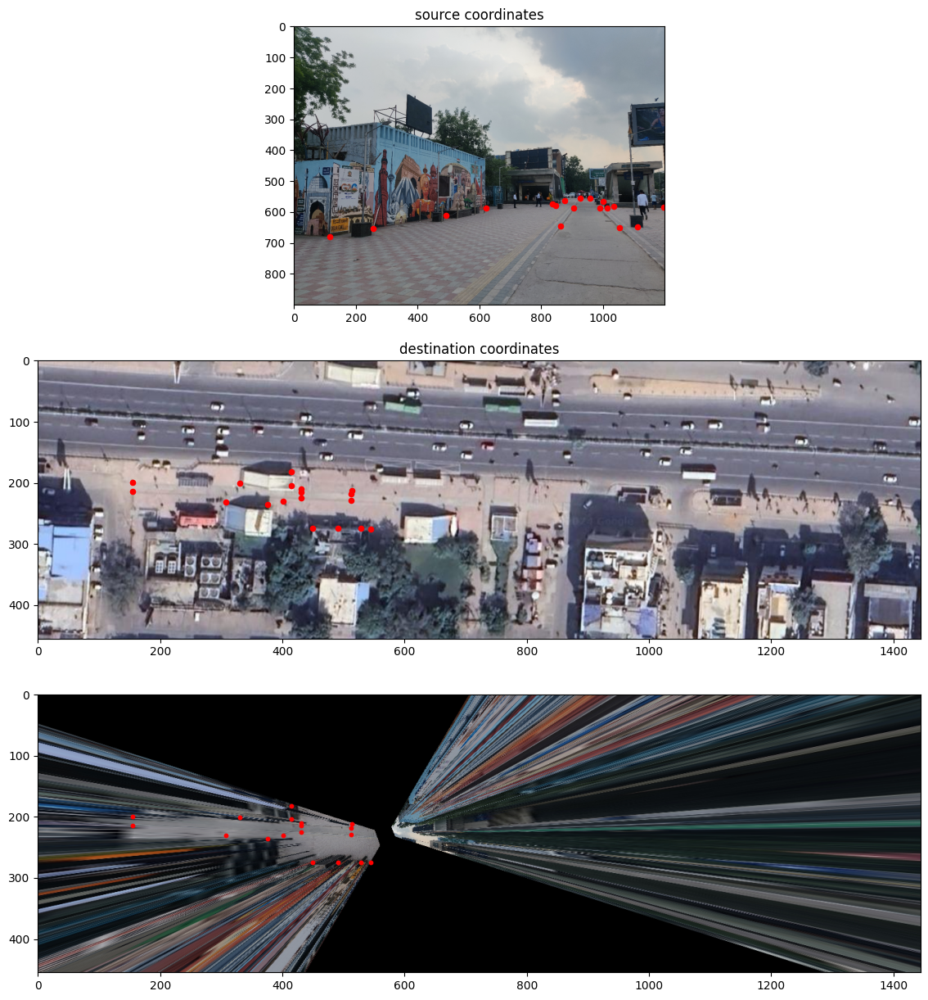

In [18]:
fig, ax = plt.subplots(3, 1, figsize=(25, 15))
ax[0].imshow(cv2.cvtColor(im_src, cv2.COLOR_BGR2RGB))
ax[0].scatter(pts_src[:,0], pts_src[:,1], c='red', s=20)
ax[0].set_title('source coordinates')
ax[1].imshow(cv2.cvtColor(im_dst, cv2.COLOR_BGR2RGB) )
ax[1].scatter(pts_dst[:,0], pts_dst[:,1], c='red', s=20)
ax[1].set_title('destination coordinates')
ax[2].imshow(cv2.cvtColor(im_out, cv2.COLOR_BGR2RGB))
ax[2].scatter(pts_dst[:,0], pts_dst[:,1], c='red', s=10)

In [19]:
ei = [[1, 0, 0],[0,1,0],[0,0,1]]

pi_a = h * ei
pi_b = h2 * ei

In [20]:
print(h2)
print(pi_a-pi_b)

[[-3.76525680e-03 -1.04386407e+00  5.78250917e+02]
 [ 9.99635591e-03 -4.17841527e-01  2.16544886e+02]
 [-1.55035961e-05 -1.82773352e-03  1.00000000e+00]]
[[-0.05817307  0.          0.        ]
 [-0.         -0.77959344  0.        ]
 [ 0.          0.          0.        ]]


In [21]:
im_src = cv2.resize(cv2.imread('pictures/image9.jpg'), (1200, 900))
pts_src = []
im_dst = cv2.imread('pictures/gmap.png')
pts_dst = []

In [22]:
im_src_copy = im_src
im_dst_copy = im_dst
def select_point(event, x, y, flags, param):
    if event == cv2.EVENT_LBUTTONDOWN:  # On left mouse button click
        if param == 'src':
            pts_src.append((x, y))  # Store clicked coordinates
            cv2.circle(im_src, (x, y), 3, (255, 0, 0), -1)  # Draw a circle at the clicked point
            cv2.imshow('Select Source Points', im_src_copy)  # Update the display
        elif param == 'dst':
            pts_dst.append((x, y))  # Store clicked coordinates
            cv2.circle(im_dst, (x, y), 2, (255, 0, 0), -1)  # Draw a circle at the clicked point
            cv2.imshow('Select Destination Points', im_dst_copy)  # Update the display

# def select_point_gmap(event, x, y, flags, param):
#     if event == cv2.EVENT_LBUTTONDOWN:  # On left mouse button click

cv2.imshow('Select Source Points', im_src_copy)  # Show the image in a window
cv2.imshow('Select Destination Points', im_dst_copy)
cv2.setMouseCallback('Select Source Points', select_point, 'src')  # Set the mouse callback function
cv2.setMouseCallback('Select Destination Points', select_point, 'dst')  # Set the mouse callback function

while True:
    key = cv2.waitKey(0)  # Wait for a key press
    if key == 27:  # If 'Esc' key is pressed
        break  # Exit the loop

cv2.destroyAllWindows()
print(pts_src, pts_dst)

[] []


[(800, 284), (664, 283), (243, 282), (73, 305), (1042, 320), (716, 339), (487, 268), (298, 281)] [(412, 181), (411, 205), (449, 265), (495, 267), (502, 180), (514, 212), (373, 235), (446, 263)]

In [23]:
pts_src = np.array([(800, 280), (664, 283), (243, 282), (73, 305), (1042, 320), (731, 339), (686, 344), (512, 343), (487, 268), (298, 281)]).reshape(-1,2)
pts_dst = np.array([(412, 181), (411, 205), (449, 265), (495, 267), (502, 180), (514, 212), (514, 218), (514, 228), (373, 235), (446, 263)]).reshape(-1,2)

Text(0.5, 1.0, 'destination coordinates')

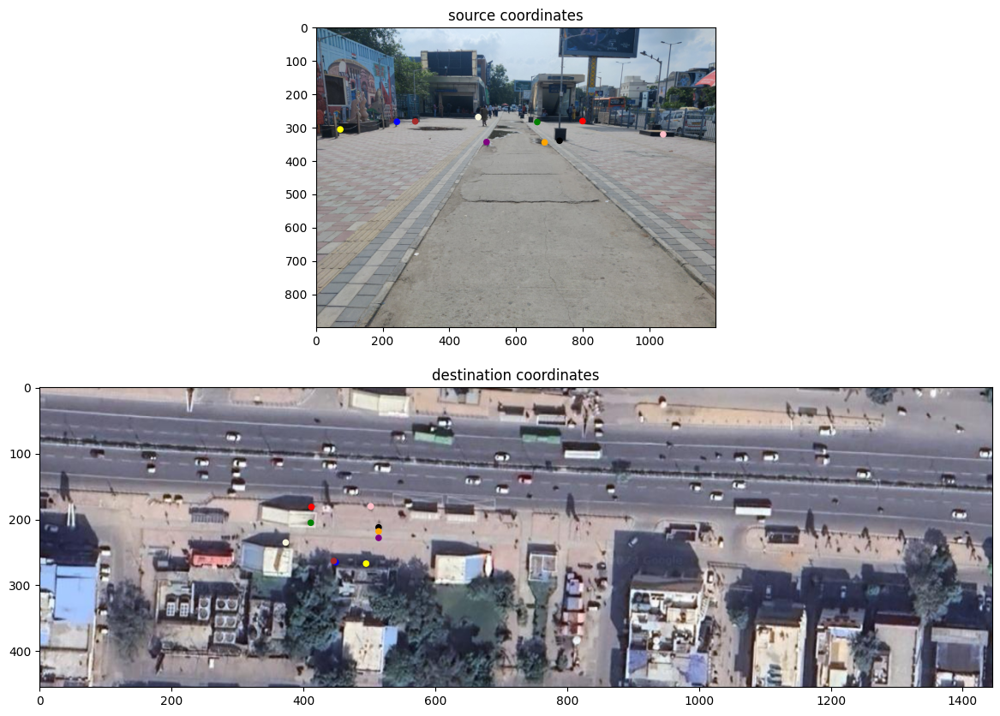

In [24]:
ig, ax = plt.subplots(2, 1, figsize=(25, 10))
color_list = ["red","green","blue","yellow","pink","black","orange","purple","beige","brown","gray","cyan","magenta", "red","green","blue","yellow","pink","black","orange","purple","beige","brown","gray","cyan","magenta"]
colors = np.array(color_list[:len(pts_src)])
ax[0].imshow(cv2.cvtColor(im_src, cv2.COLOR_BGR2RGB))
ax[0].scatter(pts_src[:,0], pts_src[:,1], c=colors, s=20)
ax[0].set_title('source coordinates')
ax[1].imshow(cv2.cvtColor(im_dst, cv2.COLOR_BGR2RGB))
ax[1].scatter(pts_dst[:,0], pts_dst[:,1], c=colors, s=20)
ax[1].set_title('destination coordinates')

In [25]:
h2, status = cv2.findHomography(pts_src, pts_dst)

In [26]:
print(np.sum(status))

10


In [27]:
im_out = cv2.warpPerspective(im_src, h2, (im_dst.shape[1],im_dst.shape[0]), flags=cv2.INTER_LINEAR)

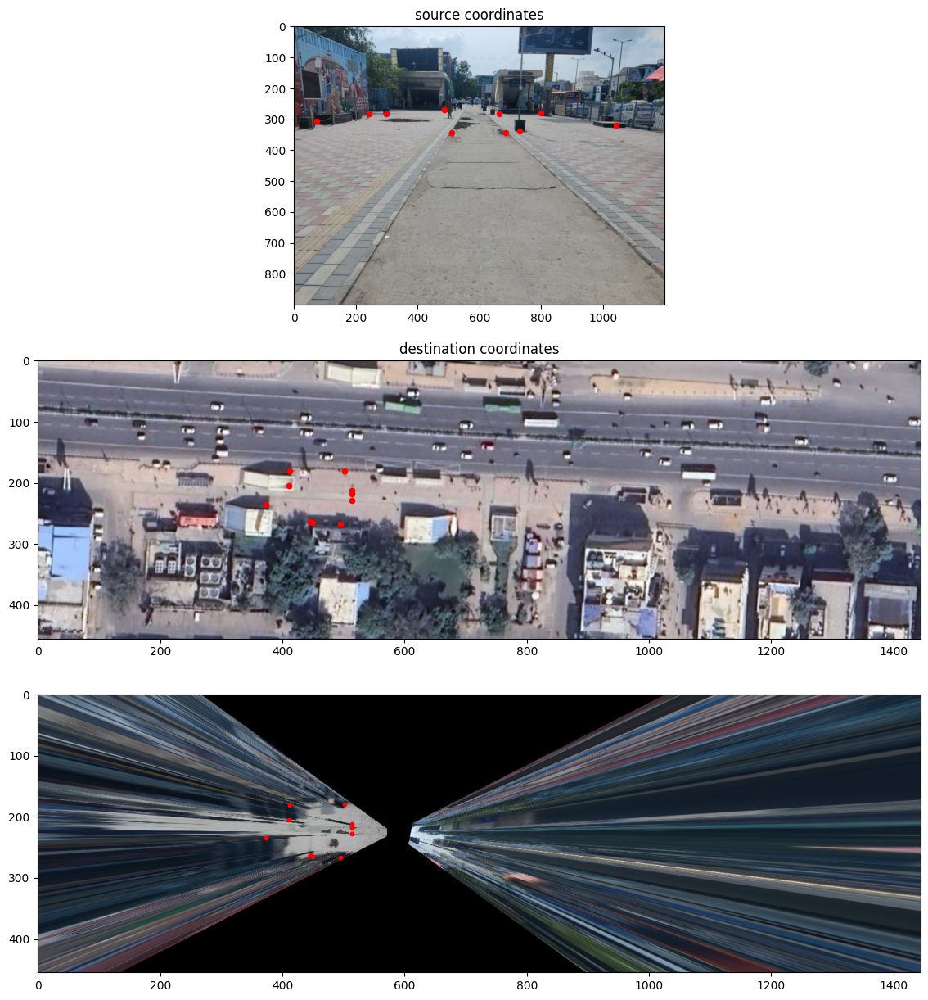

In [28]:
fig, ax = plt.subplots(3, 1, figsize=(25, 15))
ax[0].imshow(cv2.cvtColor(im_src, cv2.COLOR_BGR2RGB))
ax[0].scatter(pts_src[:,0], pts_src[:,1], c='red', s=20)
ax[0].set_title('source coordinates')
ax[1].imshow(cv2.cvtColor(im_dst, cv2.COLOR_BGR2RGB) )
ax[1].scatter(pts_dst[:,0], pts_dst[:,1], c='red', s=20)
ax[1].set_title('destination coordinates')
ax[2].imshow(cv2.cvtColor(im_out, cv2.COLOR_BGR2RGB))
ax[2].scatter(pts_dst[:,0], pts_dst[:,1], c='red', s=10)

In [29]:
object_locations = [(731, 339)]

# Convert object locations to float32 and reshape
object_locations_array = np.array(object_locations, dtype=np.float32).reshape(-1, 1, 2)

# Transform the object location points using the homography matrix
transformed_object_locations = cv2.perspectiveTransform(object_locations_array, h2)

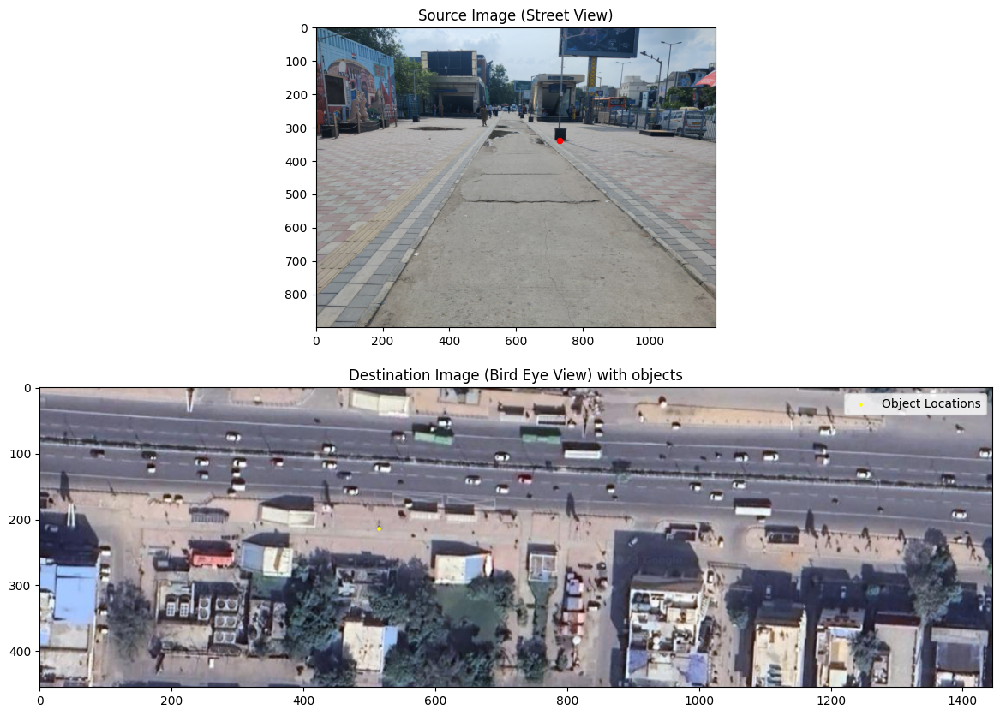

In [30]:
plt.figure(figsize=(35, 10))

# Show the source image with corresponding points
plt.subplot(2, 1, 1)
plt.imshow(cv2.cvtColor(im_src, cv2.COLOR_BGR2RGB))
plt.scatter(object_locations_array[:, 0, 0], object_locations_array[:, 0, 1], c='red', s=20, marker='o', label='Object Locations')
plt.title('Source Image (Street View)')

# Show the combined image with superimposed street view
plt.subplot(2, 1, 2)
plt.imshow(cv2.cvtColor(im_dst, cv2.COLOR_BGR2RGB))
plt.scatter(transformed_object_locations[:, 0, 0], transformed_object_locations[:, 0, 1], c='yellow', s=5, marker='o', label='Object Locations')

plt.title('Destination Image (Bird Eye View) with objects')
plt.legend()

plt.show()

In [31]:
im_src = cv2.resize(cv2.imread('pictures1/image3.jpg'), (1200, 900))
pts_src = []
im_dst = cv2.imread('pictures/gmap.png')
pts_dst = []

In [32]:
im_src_copy = im_src
im_dst_copy = im_dst
def select_point(event, x, y, flags, param):
    if event == cv2.EVENT_LBUTTONDOWN:  # On left mouse button click
        if param == 'src':
            pts_src.append((x, y))  # Store clicked coordinates
            cv2.circle(im_src, (x, y), 3, (255, 0, 0), -1)  # Draw a circle at the clicked point
            cv2.imshow('Select Source Points', im_src_copy)  # Update the display
        elif param == 'dst':
            pts_dst.append((x, y))  # Store clicked coordinates
            cv2.circle(im_dst, (x, y), 2, (255, 0, 0), -1)  # Draw a circle at the clicked point
            cv2.imshow('Select Destination Points', im_dst_copy)  # Update the display

# def select_point_gmap(event, x, y, flags, param):
#     if event == cv2.EVENT_LBUTTONDOWN:  # On left mouse button click

cv2.imshow('Select Source Points', im_src_copy)  # Show the image in a window
cv2.imshow('Select Destination Points', im_dst_copy)
cv2.setMouseCallback('Select Source Points', select_point, 'src')  # Set the mouse callback function
cv2.setMouseCallback('Select Destination Points', select_point, 'dst')  # Set the mouse callback function

while True:
    key = cv2.waitKey(0)  # Wait for a key press
    if key == 27:  # If 'Esc' key is pressed
        break  # Exit the loop

cv2.destroyAllWindows()
print(pts_src, pts_dst)

[] []


[(64, 390), (191, 389), (1017, 388), (564, 388), (23, 517), (531, 614)] [(543, 271), (530, 270), (450, 266), (492, 268), (515, 213), (498, 203)]

In [33]:
pts_src = np.array([(64, 390), (191, 389), (1017, 388), (564, 388), (23, 517), (531, 614)]).reshape(-1,2)
pts_dst = np.array([(543, 271), (530, 270), (450, 266), (492, 268), (515, 213), (498, 203)]).reshape(-1,2)

Text(0.5, 1.0, 'destination coordinates')

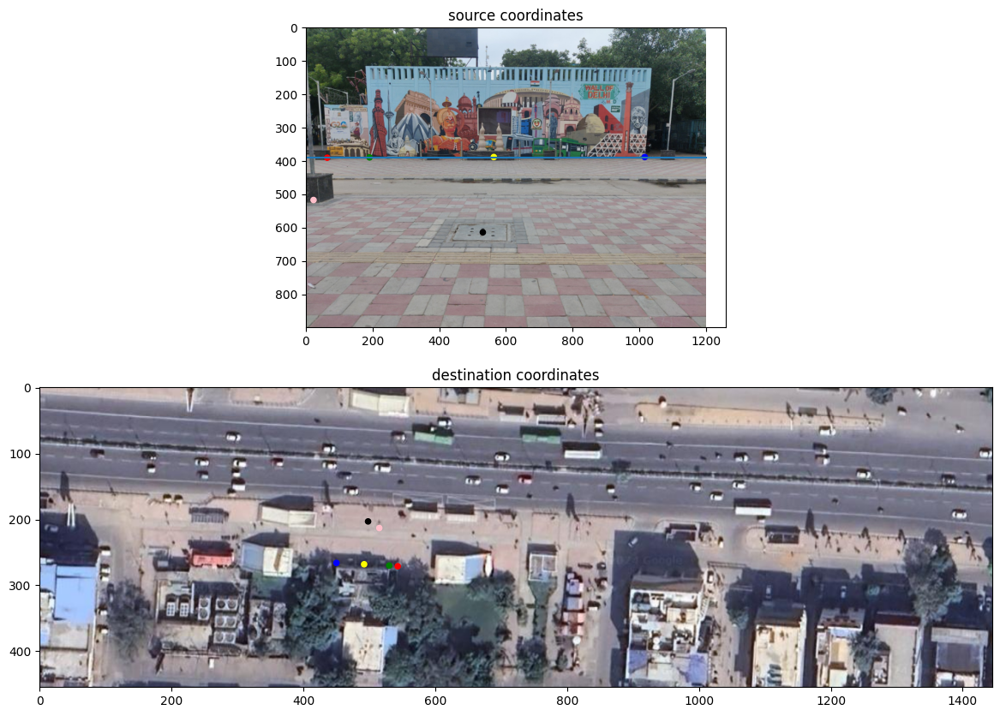

In [34]:
ig, ax = plt.subplots(2, 1, figsize=(25, 10))
color_list = ["red","green","blue","yellow","pink","black","orange","purple","beige","brown","gray","cyan","magenta", "red","green","blue","yellow","pink","black","orange","purple","beige","brown","gray","cyan","magenta"]
colors = np.array(color_list[:len(pts_src)])
ax[0].imshow(cv2.cvtColor(im_src, cv2.COLOR_BGR2RGB))
ax[0].scatter(pts_src[:,0], pts_src[:,1], c=colors, s=20)
x1, y1 = [0, 1200], [390, 390]
ax[0].plot(x1, y1)
ax[0].set_title('source coordinates')
ax[1].imshow(cv2.cvtColor(im_dst, cv2.COLOR_BGR2RGB))
ax[1].scatter(pts_dst[:,0], pts_dst[:,1], c=colors, s=20)
ax[1].set_title('destination coordinates')

In [35]:
h2, status = cv2.findHomography(pts_src, pts_dst, cv2.RANSAC)

In [36]:
print(np.sum(status))

6


In [37]:
im_out = cv2.warpPerspective(im_src, h2, (im_dst.shape[1],im_dst.shape[0]), flags=cv2.INTER_LINEAR)

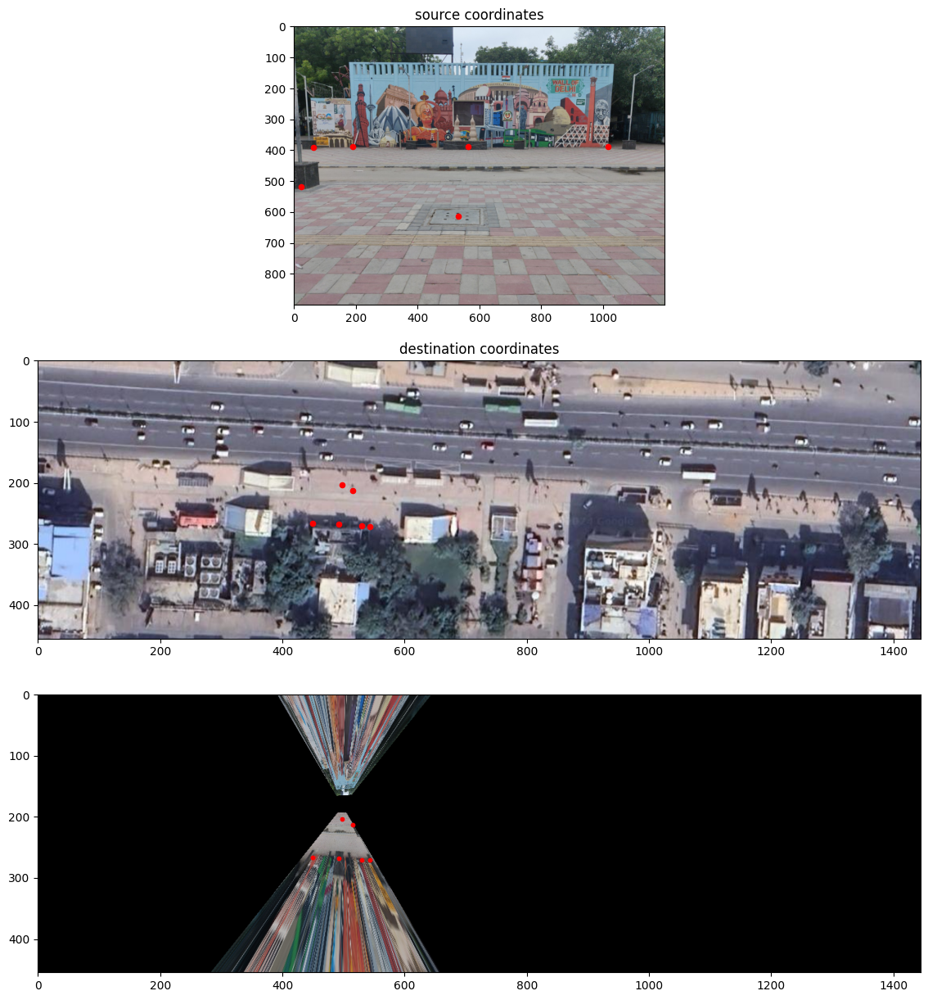

In [38]:
fig, ax = plt.subplots(3, 1, figsize=(25, 15))
ax[0].imshow(cv2.cvtColor(im_src, cv2.COLOR_BGR2RGB))
ax[0].scatter(pts_src[:,0], pts_src[:,1], c='red', s=20)
ax[0].set_title('source coordinates')
ax[1].imshow(cv2.cvtColor(im_dst, cv2.COLOR_BGR2RGB) )
ax[1].scatter(pts_dst[:,0], pts_dst[:,1], c='red', s=20)
ax[1].set_title('destination coordinates')
ax[2].imshow(cv2.cvtColor(im_out, cv2.COLOR_BGR2RGB))
ax[2].scatter(pts_dst[:,0], pts_dst[:,1], c='red', s=10)

In [39]:
ei = np.array([[1, 0, 0],[0, 1, 0],[0, 0, 1]])
pi_1 = h2 * ei

In [40]:
im_src = cv2.resize(cv2.imread('pictures1/image6.jpg'), (1200, 900))
pts_src = []
im_dst = cv2.imread('pictures/gmap.png')
pts_dst = []

In [41]:
im_src_copy = im_src
im_dst_copy = im_dst
def select_point(event, x, y, flags, param):
    if event == cv2.EVENT_LBUTTONDOWN:  # On left mouse button click
        if param == 'src':
            pts_src.append((x, y))  # Store clicked coordinates
            cv2.circle(im_src, (x, y), 3, (255, 0, 0), -1)  # Draw a circle at the clicked point
            cv2.imshow('Select Source Points', im_src_copy)  # Update the display
        elif param == 'dst':
            pts_dst.append((x, y))  # Store clicked coordinates
            cv2.circle(im_dst, (x, y), 2, (255, 0, 0), -1)  # Draw a circle at the clicked point
            cv2.imshow('Select Destination Points', im_dst_copy)  # Update the display

# def select_point_gmap(event, x, y, flags, param):
#     if event == cv2.EVENT_LBUTTONDOWN:  # On left mouse button click

cv2.imshow('Select Source Points', im_src_copy)  # Show the image in a window
cv2.imshow('Select Destination Points', im_dst_copy)
cv2.setMouseCallback('Select Source Points', select_point, 'src')  # Set the mouse callback function
cv2.setMouseCallback('Select Destination Points', select_point, 'dst')  # Set the mouse callback function

while True:
    key = cv2.waitKey(0)  # Wait for a key press
    if key == 27:  # If 'Esc' key is pressed
        break  # Exit the loop

cv2.destroyAllWindows()
print(pts_src, pts_dst)

[] []


[(53, 418), (181, 417), (560, 416), (998, 418), (21, 559), (519, 661)] [(543, 271), (529, 271), (496, 270), (450, 269), (514, 212), (498, 203)]

In [42]:
pts_src = np.array([(53, 418), (181, 417), (560, 416), (998, 418), (21, 559), (519, 661)]).reshape(-1,2)
pts_dst = np.array([(543, 271), (529, 271), (496, 270), (450, 269), (514, 212), (498, 203)]).reshape(-1,2)

Text(0.5, 1.0, 'destination coordinates')

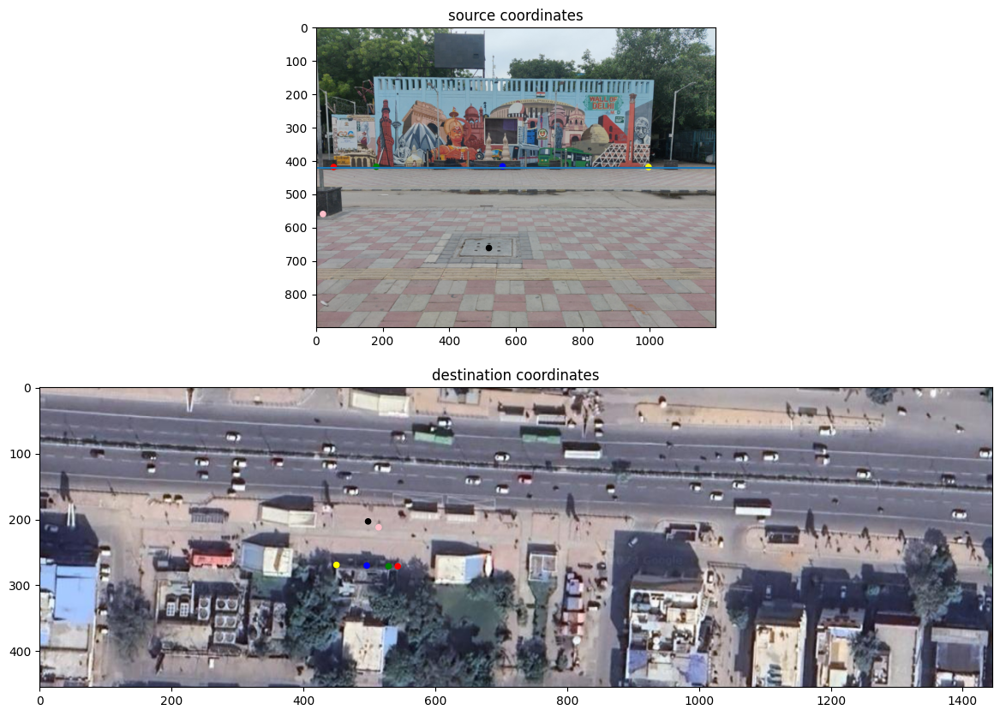

In [43]:
ig, ax = plt.subplots(2, 1, figsize=(25, 10))
color_list = ["red","green","blue","yellow","pink","black","orange","purple","beige","brown","gray","cyan","magenta", "red","green","blue","yellow","pink","black","orange","purple","beige","brown","gray","cyan","magenta"]
colors = np.array(color_list[:len(pts_src)])
ax[0].imshow(cv2.cvtColor(im_src, cv2.COLOR_BGR2RGB))
ax[0].scatter(pts_src[:,0], pts_src[:,1], c=colors, s=20)
x1, y1 = [0, 1199], [420, 420]
ax[0].plot(x1, y1)
ax[0].set_title('source coordinates')
ax[1].imshow(cv2.cvtColor(im_dst, cv2.COLOR_BGR2RGB))
ax[1].scatter(pts_dst[:,0], pts_dst[:,1], c=colors, s=20)
ax[1].set_title('destination coordinates')

In [44]:
h2, status = cv2.findHomography(pts_src, pts_dst)
print(h2)

[[ 2.92139908e-02 -1.44367295e+00  4.87556446e+02]
 [ 5.61891012e-03 -5.31256944e-01  1.64798542e+02]
 [ 1.94784743e-05 -2.89961990e-03  1.00000000e+00]]


In [45]:
print(np.sum(status))

6


In [46]:
im_out = cv2.warpPerspective(im_src, h2, (im_dst.shape[1],im_dst.shape[0]), flags=cv2.INTER_LINEAR)

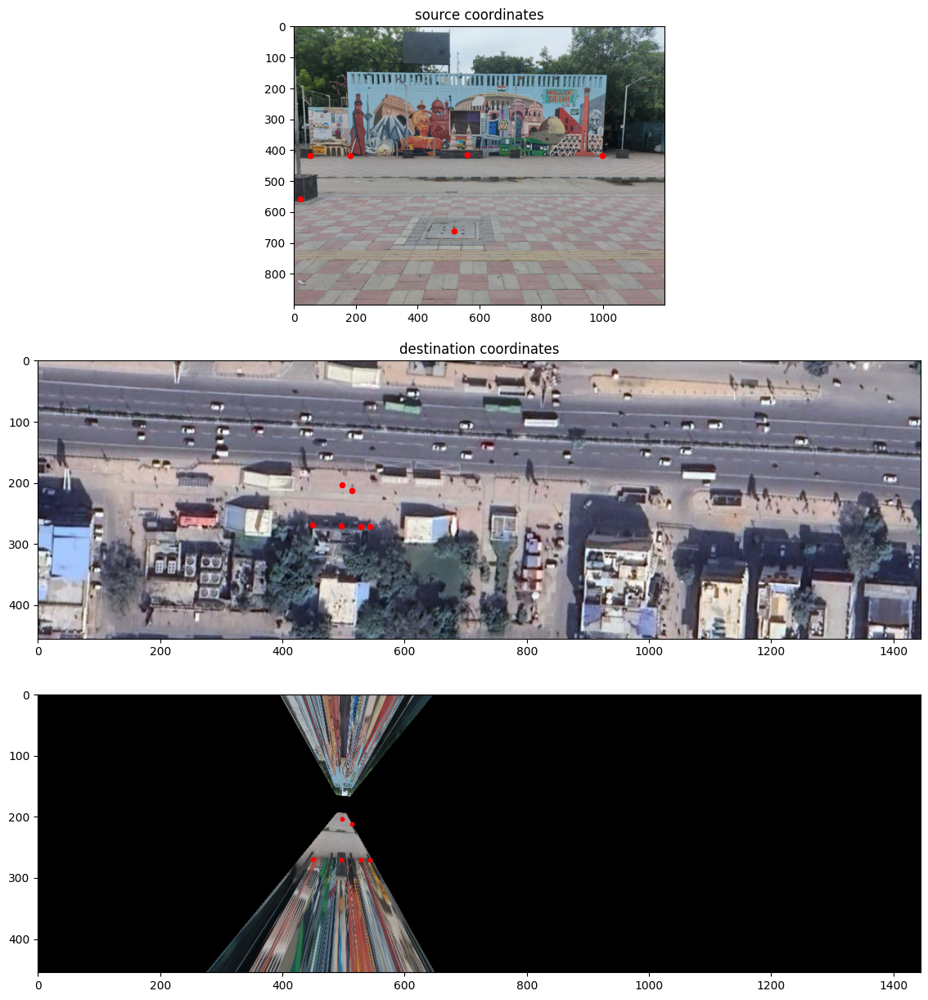

In [47]:
fig, ax = plt.subplots(3, 1, figsize=(25, 15))
ax[0].imshow(cv2.cvtColor(im_src, cv2.COLOR_BGR2RGB))
ax[0].scatter(pts_src[:,0], pts_src[:,1], c='red', s=20)
ax[0].set_title('source coordinates')
ax[1].imshow(cv2.cvtColor(im_dst, cv2.COLOR_BGR2RGB) )
ax[1].scatter(pts_dst[:,0], pts_dst[:,1], c='red', s=20)
ax[1].set_title('destination coordinates')
ax[2].imshow(cv2.cvtColor(im_out, cv2.COLOR_BGR2RGB))
ax[2].scatter(pts_dst[:,0], pts_dst[:,1], c='red', s=10)

In [48]:
pi_2 = h2 * ei

In [49]:
print(pi_1 - pi_2)

[[-0.02188808  0.          0.        ]
 [-0.         -0.03267506  0.        ]
 [-0.          0.          0.        ]]


In [50]:
im_src = cv2.resize(cv2.imread('pictures1/image4.jpg'), (1200, 900))
pts_src = []
im_dst = cv2.imread('pictures/gmap.png')
pts_dst = []

In [51]:
im_src_copy = im_src
im_dst_copy = im_dst
def select_point(event, x, y, flags, param):
    if event == cv2.EVENT_LBUTTONDOWN:  # On left mouse button click
        if param == 'src':
            pts_src.append((x, y))  # Store clicked coordinates
            cv2.circle(im_src, (x, y), 3, (255, 0, 0), -1)  # Draw a circle at the clicked point
            cv2.imshow('Select Source Points', im_src_copy)  # Update the display
        elif param == 'dst':
            pts_dst.append((x, y))  # Store clicked coordinates
            cv2.circle(im_dst, (x, y), 2, (255, 0, 0), -1)  # Draw a circle at the clicked point
            cv2.imshow('Select Destination Points', im_dst_copy)  # Update the display

# def select_point_gmap(event, x, y, flags, param):
#     if event == cv2.EVENT_LBUTTONDOWN:  # On left mouse button click

cv2.imshow('Select Source Points', im_src_copy)  # Show the image in a window
cv2.imshow('Select Destination Points', im_dst_copy)
cv2.setMouseCallback('Select Source Points', select_point, 'src')  # Set the mouse callback function
cv2.setMouseCallback('Select Destination Points', select_point, 'dst')  # Set the mouse callback function

while True:
    key = cv2.waitKey(0)  # Wait for a key press
    if key == 27:  # If 'Esc' key is pressed
        break  # Exit the loop

cv2.destroyAllWindows()
print(pts_src, pts_dst)

[] []


[(53, 418), (181, 417), (560, 416), (998, 418), (21, 559), (519, 661)] [(543, 271), (529, 271), (496, 270), (450, 269), (514, 212), (498, 203)]

In [52]:
pts_src = np.array([(74, 563), (199, 561), (573, 558), (1028, 560), (23, 694), (538, 800)]).reshape(-1,2)
pts_dst = np.array([(543, 271), (529, 271), (496, 270), (450, 269), (514, 212), (498, 203)]).reshape(-1,2)

Text(0.5, 1.0, 'destination coordinates')

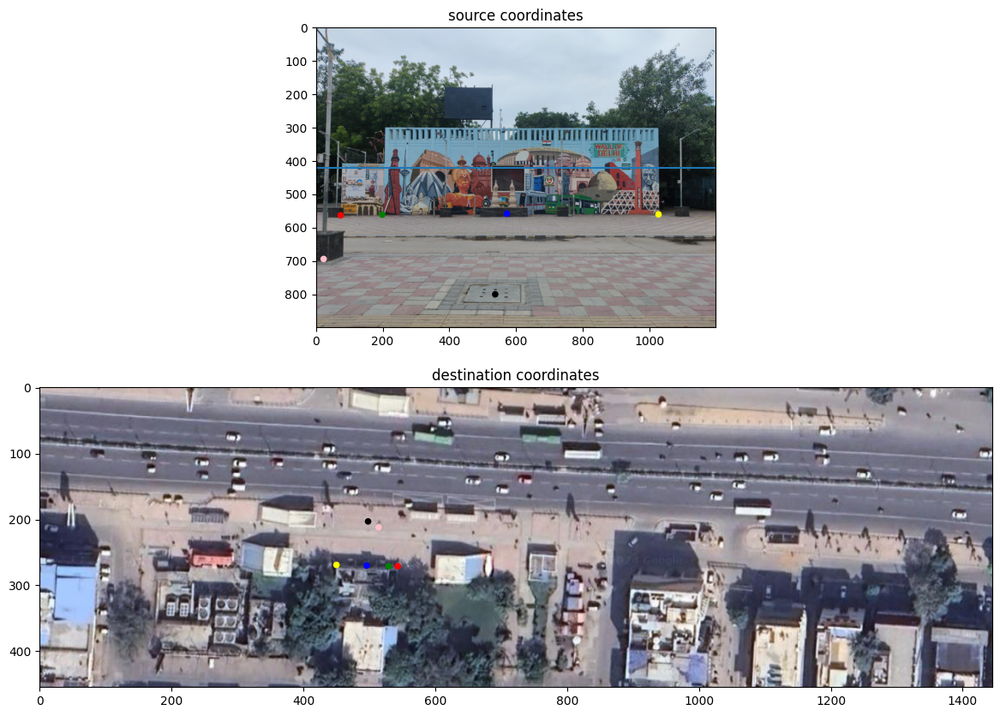

In [53]:
ig, ax = plt.subplots(2, 1, figsize=(25, 10))
color_list = ["red","green","blue","yellow","pink","black","orange","purple","beige","brown","gray","cyan","magenta", "red","green","blue","yellow","pink","black","orange","purple","beige","brown","gray","cyan","magenta"]
colors = np.array(color_list[:len(pts_src)])
ax[0].imshow(cv2.cvtColor(im_src, cv2.COLOR_BGR2RGB))
ax[0].scatter(pts_src[:,0], pts_src[:,1], c=colors, s=20)
x1, y1 = [0, 1199], [420, 420]
ax[0].plot(x1, y1)
ax[0].set_title('source coordinates')
ax[1].imshow(cv2.cvtColor(im_dst, cv2.COLOR_BGR2RGB))
ax[1].scatter(pts_dst[:,0], pts_dst[:,1], c=colors, s=20)
ax[1].set_title('destination coordinates')

In [54]:
h2, status = cv2.findHomography(pts_src, pts_dst)

In [55]:
print(np.sum(status))

6


In [56]:
im_out = cv2.warpPerspective(im_src, h2, (im_dst.shape[1],im_dst.shape[0]), flags=cv2.INTER_LINEAR)

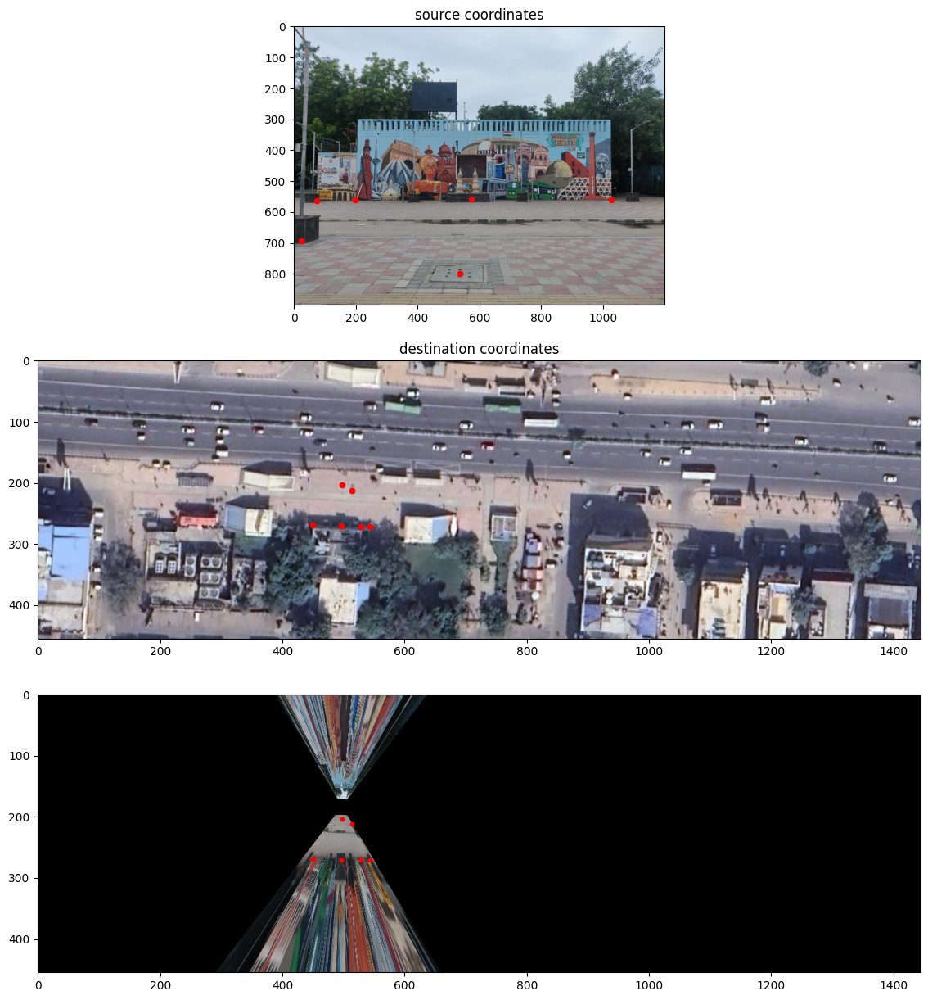

In [57]:
fig, ax = plt.subplots(3, 1, figsize=(25, 15))
ax[0].imshow(cv2.cvtColor(im_src, cv2.COLOR_BGR2RGB))
ax[0].scatter(pts_src[:,0], pts_src[:,1], c='red', s=20)
ax[0].set_title('source coordinates')
ax[1].imshow(cv2.cvtColor(im_dst, cv2.COLOR_BGR2RGB) )
ax[1].scatter(pts_dst[:,0], pts_dst[:,1], c='red', s=20)
ax[1].set_title('destination coordinates')
ax[2].imshow(cv2.cvtColor(im_out, cv2.COLOR_BGR2RGB))
ax[2].scatter(pts_dst[:,0], pts_dst[:,1], c='red', s=10)

In [58]:
im_src = cv2.resize(cv2.imread('pictures1/image6.jpg'), (1200, 900))
pts_src = []
im_dst = cv2.imread('gmap.png')
pts_dst = []

In [59]:
im_src_copy = im_src
im_dst_copy = im_dst
def select_point(event, x, y, flags, param):
    if event == cv2.EVENT_LBUTTONDOWN:  # On left mouse button click
        if param == 'src':
            pts_src.append((x, y))  # Store clicked coordinates
            cv2.circle(im_src, (x, y), 3, (255, 0, 0), -1)  # Draw a circle at the clicked point
            cv2.imshow('Select Source Points', im_src_copy)  # Update the display
        elif param == 'dst':
            pts_dst.append((x, y))  # Store clicked coordinates
            cv2.circle(im_dst, (x, y), 2, (255, 0, 0), -1)  # Draw a circle at the clicked point
            cv2.imshow('Select Destination Points', im_dst_copy)  # Update the display

# def select_point_gmap(event, x, y, flags, param):
#     if event == cv2.EVENT_LBUTTONDOWN:  # On left mouse button click

cv2.imshow('Select Source Points', im_src_copy)  # Show the image in a window
cv2.imshow('Select Destination Points', im_dst_copy)
cv2.setMouseCallback('Select Source Points', select_point, 'src')  # Set the mouse callback function
cv2.setMouseCallback('Select Destination Points', select_point, 'dst')  # Set the mouse callback function

while True:
    key = cv2.waitKey(0)  # Wait for a key press
    if key == 27:  # If 'Esc' key is pressed
        break  # Exit the loop

cv2.destroyAllWindows()
print(pts_src, pts_dst)

[] []


[(53, 417), (180, 416), (367, 416), (542, 416), (713, 417), (998, 418), (1064, 426), (21, 558), (517, 659)] [(1072, 383), (1033, 382), (982, 381), (933, 379), (883, 379), (790, 376), (780, 340), (988, 191), (942, 172)]


In [60]:
pts_src = np.array([(53, 417), (180, 416), (367, 416), (542, 416), (713, 417), (998, 418), (1064, 426), (21, 558), (517, 659)]).reshape(-1,2)
pts_dst = np.array([(1075, 367), (1035, 364), (980, 363), (932, 362), (886, 360), (793, 358), (786, 337), (988, 191), (942, 172)]).reshape(-1,2)

Text(0.5, 1.0, 'destination coordinates')

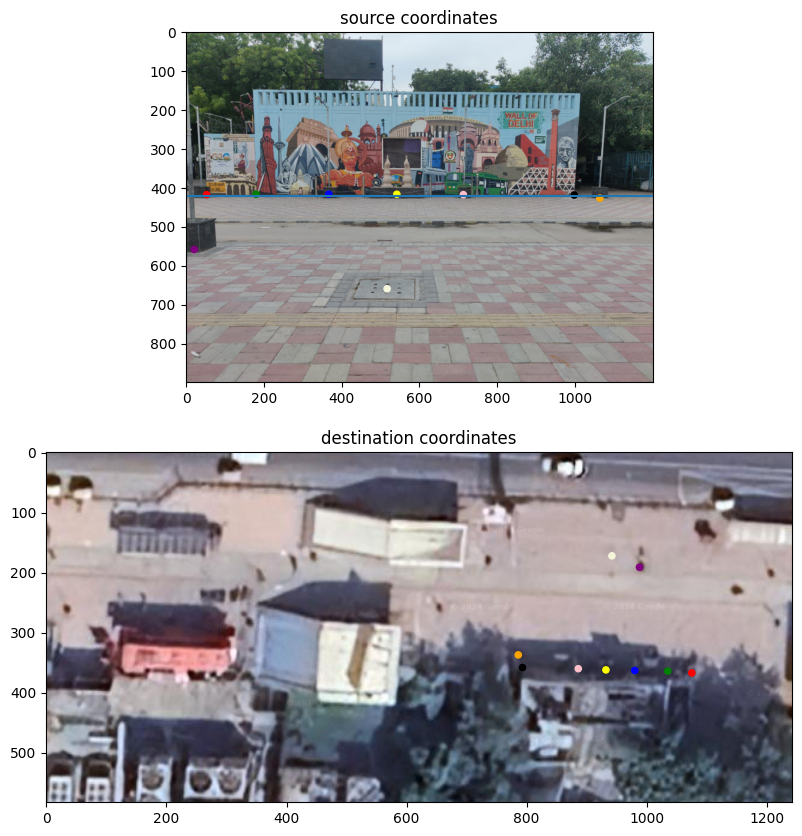

In [61]:
ig, ax = plt.subplots(2, 1, figsize=(25, 10))
color_list = ["red","green","blue","yellow","pink","black","orange","purple","beige","brown","gray","cyan","magenta", "red","green","blue","yellow","pink","black","orange","purple","beige","brown","gray","cyan","magenta"]
colors = np.array(color_list[:len(pts_src)])
ax[0].imshow(cv2.cvtColor(im_src, cv2.COLOR_BGR2RGB))
ax[0].scatter(pts_src[:,0], pts_src[:,1], c=colors, s=20)
x1, y1 = [0, 1199], [420, 420]
ax[0].plot(x1, y1)
ax[0].set_title('source coordinates')
ax[1].imshow(cv2.cvtColor(im_dst, cv2.COLOR_BGR2RGB))
ax[1].scatter(pts_dst[:,0], pts_dst[:,1], c=colors, s=20)
ax[1].set_title('destination coordinates')

In [62]:
h2, status = cv2.findHomography(pts_src, pts_dst)

In [63]:
print(np.sum(status))

9


In [64]:
im_out = cv2.warpPerspective(im_src, h2, (im_dst.shape[1],im_dst.shape[0]), flags=cv2.INTER_LINEAR)

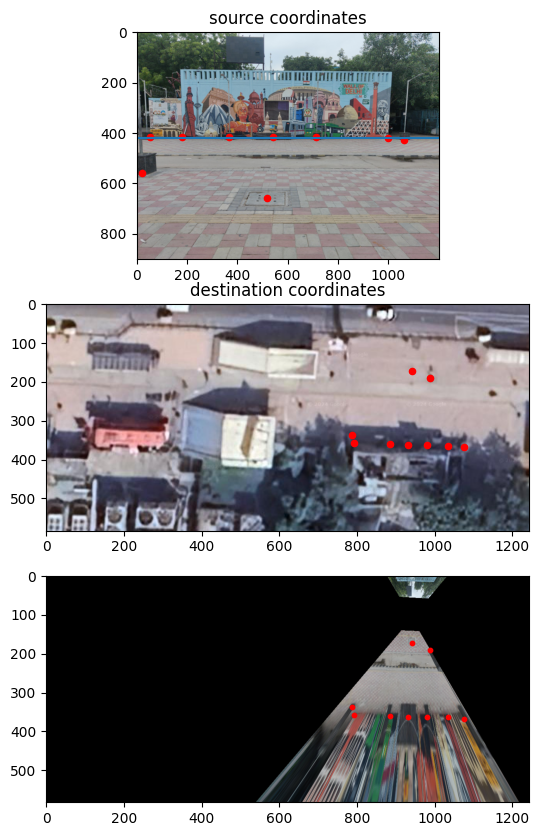

In [65]:
fig, ax = plt.subplots(3, 1, figsize=(25, 10))
ax[0].imshow(cv2.cvtColor(im_src, cv2.COLOR_BGR2RGB))
ax[0].scatter(pts_src[:,0], pts_src[:,1], c='red', s=20)
ax[0].set_title('source coordinates')
x1, y1 = [0, 1199], [420, 420]
ax[0].plot(x1, y1)
ax[1].imshow(cv2.cvtColor(im_dst, cv2.COLOR_BGR2RGB) )
ax[1].scatter(pts_dst[:,0], pts_dst[:,1], c='red', s=20)
ax[1].set_title('destination coordinates')
ax[2].imshow(cv2.cvtColor(im_out, cv2.COLOR_BGR2RGB))
ax[2].scatter(pts_dst[:,0], pts_dst[:,1], c='red', s=10)

In [66]:
im_src = cv2.resize(cv2.imread('pictures1/image15.jpg'), (1200, 900))
pts_src = []
im_dst = cv2.imread('gmap.png')
pts_dst = []

In [67]:
im_src_copy = im_src
im_dst_copy = im_dst
def select_point(event, x, y, flags, param):
    if event == cv2.EVENT_LBUTTONDOWN:  # On left mouse button click
        if param == 'src':
            pts_src.append((x, y))  # Store clicked coordinates
            cv2.circle(im_src, (x, y), 3, (255, 0, 0), -1)  # Draw a circle at the clicked point
            cv2.imshow('Select Source Points', im_src_copy)  # Update the display
        elif param == 'dst':
            pts_dst.append((x, y))  # Store clicked coordinates
            cv2.circle(im_dst, (x, y), 2, (255, 0, 0), -1)  # Draw a circle at the clicked point
            cv2.imshow('Select Destination Points', im_dst_copy)  # Update the display

# def select_point_gmap(event, x, y, flags, param):
#     if event == cv2.EVENT_LBUTTONDOWN:  # On left mouse button click

cv2.imshow('Select Source Points', im_src_copy)  # Show the image in a window
cv2.imshow('Select Destination Points', im_dst_copy)
cv2.setMouseCallback('Select Source Points', select_point, 'src')  # Set the mouse callback function
cv2.setMouseCallback('Select Destination Points', select_point, 'dst')  # Set the mouse callback function

while True:
    key = cv2.waitKey(0)  # Wait for a key press
    if key == 27:  # If 'Esc' key is pressed
        break  # Exit the loop

cv2.destroyAllWindows()
print(pts_src, pts_dst)

[] []


In [68]:
pts_src = np.array([(324, 399), (238, 468), (668, 363), (878, 351), (621, 482), (958, 532)]).reshape(-1,2)
pts_dst = np.array([(292, 298), (354, 250), (166, 297), (34, 260), (317, 214), (317, 165)]).reshape(-1,2)

Text(0.5, 1.0, 'destination coordinates')

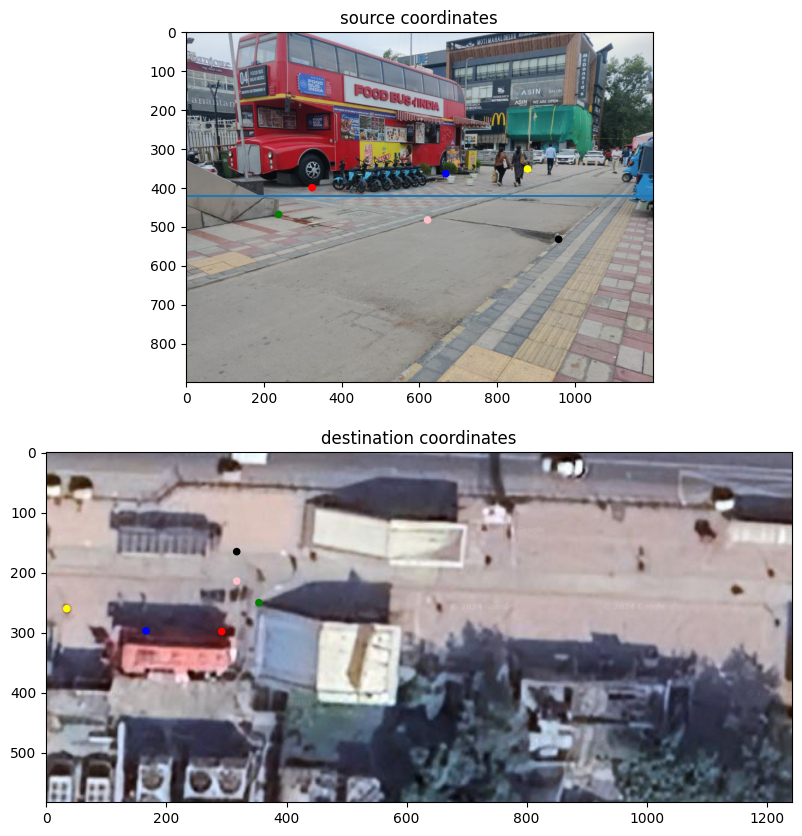

In [69]:
ig, ax = plt.subplots(2, 1, figsize=(25, 10))
color_list = ["red","green","blue","yellow","pink","black","orange","purple","beige","brown","gray","cyan","magenta", "red","green","blue","yellow","pink","black","orange","purple","beige","brown","gray","cyan","magenta"]
colors = np.array(color_list[:len(pts_src)])
ax[0].imshow(cv2.cvtColor(im_src, cv2.COLOR_BGR2RGB))
ax[0].scatter(pts_src[:,0], pts_src[:,1], c=colors, s=20)
x1, y1 = [0, 1199], [420, 420]
ax[0].plot(x1, y1)
ax[0].set_title('source coordinates')
ax[1].imshow(cv2.cvtColor(im_dst, cv2.COLOR_BGR2RGB))
ax[1].scatter(pts_dst[:,0], pts_dst[:,1], c=colors, s=20)
ax[1].set_title('destination coordinates')

In [70]:
h2, status = cv2.findHomography(pts_src, pts_dst, cv2.RANSAC)

In [71]:
print(np.sum(status))

4


In [72]:
im_out = cv2.warpPerspective(im_src, h2, (im_dst.shape[1],im_dst.shape[0]), flags=cv2.INTER_LINEAR)

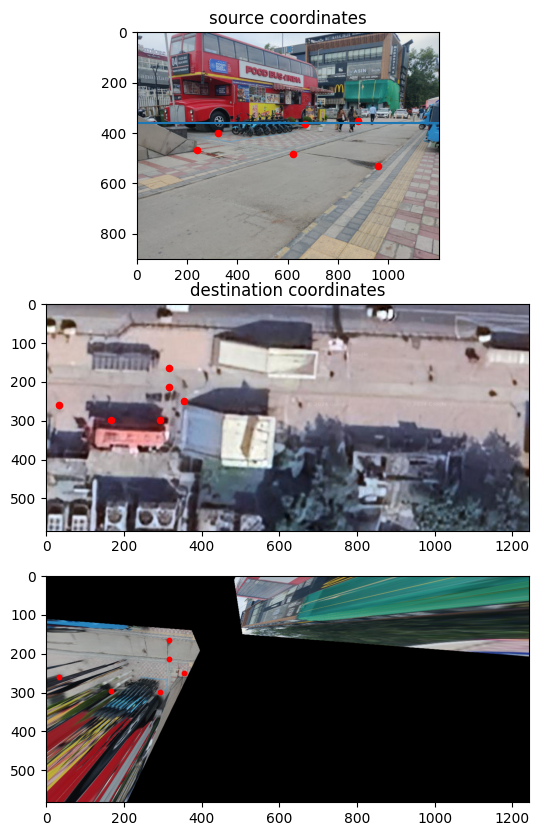

In [73]:
fig, ax = plt.subplots(3, 1, figsize=(25, 10))
ax[0].imshow(cv2.cvtColor(im_src, cv2.COLOR_BGR2RGB))
ax[0].scatter(pts_src[:,0], pts_src[:,1], c='red', s=20)
ax[0].set_title('source coordinates')
x1, y1 = [0, 1199], [360, 360]
ax[0].plot(x1, y1)
ax[1].imshow(cv2.cvtColor(im_dst, cv2.COLOR_BGR2RGB) )
ax[1].scatter(pts_dst[:,0], pts_dst[:,1], c='red', s=20)
ax[1].set_title('destination coordinates')
ax[2].imshow(cv2.cvtColor(im_out, cv2.COLOR_BGR2RGB))
ax[2].scatter(pts_dst[:,0], pts_dst[:,1], c='red', s=10)

In [92]:
im_src = cv2.resize(cv2.imread('pictures1/image8.jpg'), (1200, 900))
pts_src = []
im_dst = cv2.imread('gmap.png')
pts_dst = []

In [93]:
im_src_copy = im_src
im_dst_copy = im_dst
def select_point(event, x, y, flags, param):
    if event == cv2.EVENT_LBUTTONDOWN:  # On left mouse button click
        if param == 'src':
            pts_src.append((x, y))  # Store clicked coordinates
            cv2.circle(im_src, (x, y), 3, (255, 0, 0), -1)  # Draw a circle at the clicked point
            cv2.imshow('Select Source Points', im_src_copy)  # Update the display
        elif param == 'dst':
            pts_dst.append((x, y))  # Store clicked coordinates
            cv2.circle(im_dst, (x, y), 2, (255, 0, 0), -1)  # Draw a circle at the clicked point
            cv2.imshow('Select Destination Points', im_dst_copy)  # Update the display

# def select_point_gmap(event, x, y, flags, param):
#     if event == cv2.EVENT_LBUTTONDOWN:  # On left mouse button click

cv2.imshow('Select Source Points', im_src_copy)  # Show the image in a window
cv2.imshow('Select Destination Points', im_dst_copy)
cv2.setMouseCallback('Select Source Points', select_point, 'src')  # Set the mouse callback function
cv2.setMouseCallback('Select Destination Points', select_point, 'dst')  # Set the mouse callback function

while True:
    key = cv2.waitKey(0)  # Wait for a key press
    if key == 27:  # If 'Esc' key is pressed
        break  # Exit the loop

cv2.destroyAllWindows()
print(pts_src, pts_dst)

[(136, 101), (523, 113), (1009, 104), (506, 358), (13, 252)] [(1031, 373), (932, 344), (806, 367), (940, 178), (991, 191)]


In [110]:
pts_src = np.array([(136, 101), (523, 113), (1009, 104), (506, 358), (13, 252)]).reshape(-1,2)
pts_dst = np.array([(1031, 373), (932, 344), (806, 367), (940, 178), (971, 191)]).reshape(-1,2)

Text(0.5, 1.0, 'destination coordinates')

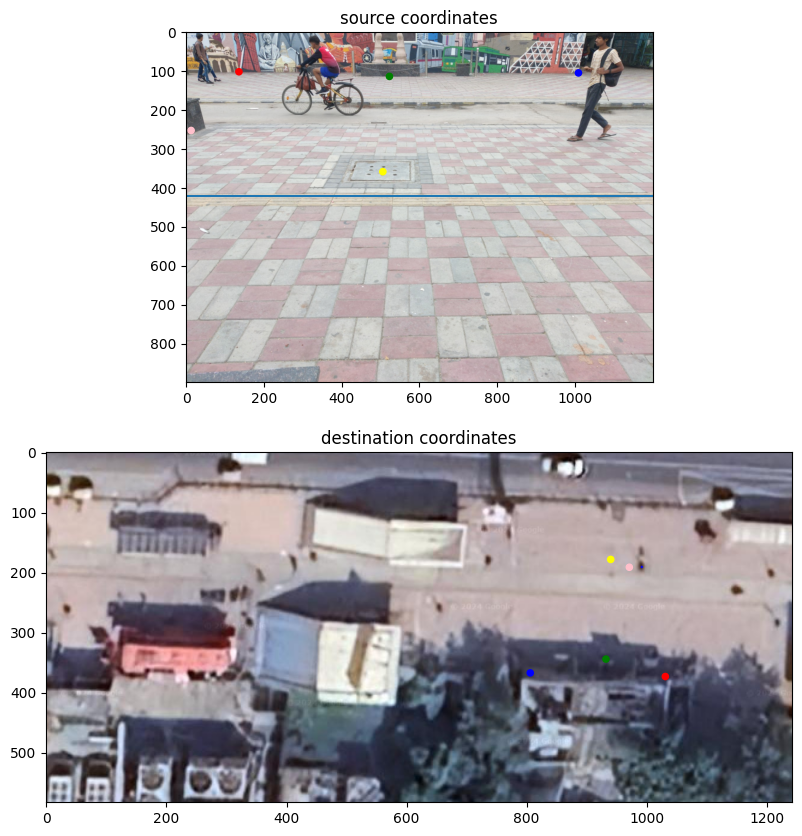

In [111]:
ig, ax = plt.subplots(2, 1, figsize=(25, 10))
color_list = ["red","green","blue","yellow","pink","black","orange","purple","beige","brown","gray","cyan","magenta", "red","green","blue","yellow","pink","black","orange","purple","beige","brown","gray","cyan","magenta"]
colors = np.array(color_list[:len(pts_src)])
ax[0].imshow(cv2.cvtColor(im_src, cv2.COLOR_BGR2RGB))
ax[0].scatter(pts_src[:,0], pts_src[:,1], c=colors, s=20)
x1, y1 = [0, 1199], [420, 420]
ax[0].plot(x1, y1)
ax[0].set_title('source coordinates')
ax[1].imshow(cv2.cvtColor(im_dst, cv2.COLOR_BGR2RGB))
ax[1].scatter(pts_dst[:,0], pts_dst[:,1], c=colors, s=20)
ax[1].set_title('destination coordinates')

In [126]:
h2, status = cv2.findHomography(pts_src, pts_dst)

In [127]:
print(np.sum(status))

5


In [128]:
im_out = cv2.warpPerspective(im_src, h2, (im_dst.shape[1],im_dst.shape[0]), flags=cv2.INTER_LINEAR)

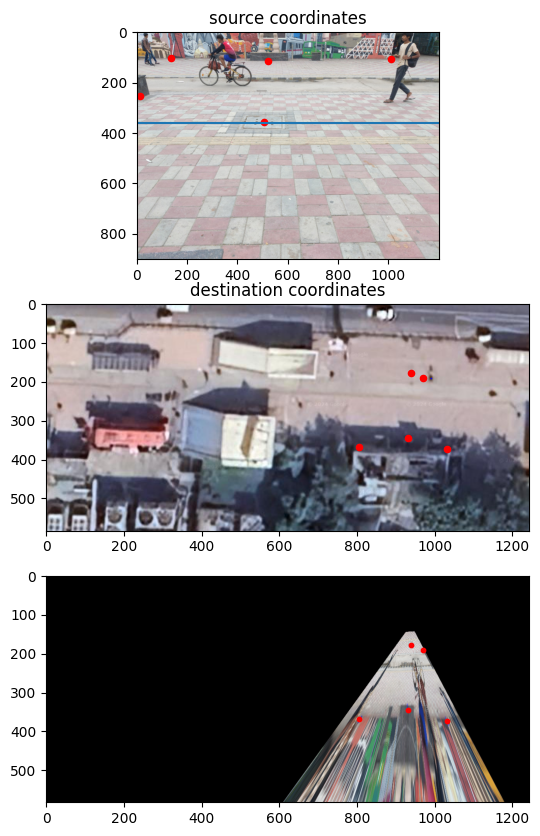

In [129]:
fig, ax = plt.subplots(3, 1, figsize=(25, 10))
ax[0].imshow(cv2.cvtColor(im_src, cv2.COLOR_BGR2RGB))
ax[0].scatter(pts_src[:,0], pts_src[:,1], c='red', s=20)
ax[0].set_title('source coordinates')
x1, y1 = [0, 1199], [360, 360]
ax[0].plot(x1, y1)
ax[1].imshow(cv2.cvtColor(im_dst, cv2.COLOR_BGR2RGB) )
ax[1].scatter(pts_dst[:,0], pts_dst[:,1], c='red', s=20)
ax[1].set_title('destination coordinates')
ax[2].imshow(cv2.cvtColor(im_out, cv2.COLOR_BGR2RGB))
ax[2].scatter(pts_dst[:,0], pts_dst[:,1], c='red', s=10)

In [130]:
# pi_3 = h2 * ei

In [131]:
# def rotation_matrix_x(theta_x):
#     return np.array([
#         [1, 0, 0],
#         [0, np.cos(theta_x), -np.sin(theta_x)],
#         [0, np.sin(theta_x), np.cos(theta_x)]
#     ])

# def rotation_matrix_y(theta_y):
#     return np.array([
#         [np.cos(theta_y), 0, np.sin(theta_y)],
#         [0, 1, 0],
#         [-np.sin(theta_y), 0, np.cos(theta_y)]
#     ])

# def rotation_matrix_z(theta_z):
#     return np.array([
#         [np.cos(theta_z), -np.sin(theta_z), 0],
#         [np.sin(theta_z), np.cos(theta_z), 0],
#         [0, 0, 1]
#     ])

# def overall_rotation_matrix(theta_x, theta_y, theta_z):
#     R_x = rotation_matrix_x(theta_x)
#     R_y = rotation_matrix_y(theta_y)
#     R_z = rotation_matrix_z(theta_z)
    
#     return np.dot(R_z, np.dot(R_y, R_x))

# def adjust_homography_matrix(H_initial, theta_x, theta_y, theta_z):
#     # Compute the overall rotation matrix
#     R = overall_rotation_matrix(theta_x, theta_y, theta_z)
    
#     # Homography matrix adjustment: Apply rotation to the homography matrix
#     H_adjusted = np.dot(H_initial, R)
    
#     return H_adjusted

# # Example homography matrix (replace with your actual matrix)

# # Angles in radians
# theta_x = np.radians(1.22)  # Pitch
# theta_y = np.radians(0)  # Yaw
# theta_z = np.radians(0)  # Roll

# # Adjust the homography matrix
# H_adjusted = adjust_homography_matrix(h2, theta_x, theta_y, theta_z)

# print("Adjusted Homography Matrix:")

# print(H_adjusted * ei)



In [132]:
# def rotation_matrix_pitch(theta):
#     return np.array([
#         [1, 0, 0],
#         [0, np.cos(theta), -np.sin(theta)],
#         [0, np.sin(theta), np.cos(theta)]
#     ])

# # Convert degrees to radians
# theta_1 = np.radians(3.30)  # Initial pitch
# theta_2 = np.radians(2.08)  # New pitch

# # Compute rotation matrices
# R_theta_1 = rotation_matrix_pitch(theta_1)
# R_theta_2 = rotation_matrix_pitch(theta_2)

# # Compute the rotation difference matrix
# R_diff = np.dot(R_theta_2, np.linalg.inv(R_theta_1))


In [133]:
# H_theta_2 = np.dot(h2, R_diff)

In [134]:
# im_out = cv2.warpPerspective(im_src, h2, (im_dst.shape[1],im_dst.shape[0]), flags=cv2.INTER_LINEAR)
# fig, ax = plt.subplots(3, 1, figsize=(25, 15))
# ax[0].imshow(cv2.cvtColor(im_src, cv2.COLOR_BGR2RGB))
# ax[0].scatter(pts_src[:,0], pts_src[:,1], c='red', s=20)
# ax[0].set_title('source coordinates')
# ax[1].imshow(cv2.cvtColor(im_dst, cv2.COLOR_BGR2RGB) )
# ax[1].scatter(pts_dst[:,0], pts_dst[:,1], c='red', s=20)
# ax[1].set_title('destination coordinates')
# ax[2].imshow(cv2.cvtColor(im_out, cv2.COLOR_BGR2RGB))
# ax[2].scatter(pts_dst[:,0], pts_dst[:,1], c='red', s=10)

In [135]:
# pi_4 = H_adjusted * ei

# print(h2)

In [136]:
# def adjust_homography_for_height(H_initial, height_change):
#     H_adjusted = H_initial.copy()
#     H_adjusted[0, 2] += height_change
#     H_adjusted[1, 2] += height_change
#     return H_adjusted

# # Example initial homography matrix
# H_initial = np.array([
#     [1.22271452e-02, -1.00696304e+00, 4.90276429e+02],
#     [2.72562452e-04, -3.71250510e-01, 1.71364513e+02],
#     [-1.88915856e-06, -2.02423565e-03, 1.00000000e+00]
# ])

# # Height change (example value)
# height_change = 0.5  # Change in height

# # Adjust homography matrix
# H_adjusted = adjust_homography_for_height(H_initial, height_change)
# print("Adjusted Homography Matrix:\n", H_adjusted)

In [137]:
# im_out = cv2.warpPerspective(im_src, H_adjusted, (im_dst.shape[1],im_dst.shape[0]), flags=cv2.INTER_LINEAR)
# fig, ax = plt.subplots(3, 1, figsize=(25, 15))
# ax[0].imshow(cv2.cvtColor(im_src, cv2.COLOR_BGR2RGB))
# ax[0].scatter(pts_src[:,0], pts_src[:,1], c='red', s=20)
# ax[0].set_title('source coordinates')
# ax[1].imshow(cv2.cvtColor(im_dst, cv2.COLOR_BGR2RGB) )
# ax[1].scatter(pts_dst[:,0], pts_dst[:,1], c='red', s=20)
# ax[1].set_title('destination coordinates')
# ax[2].imshow(cv2.cvtColor(im_out, cv2.COLOR_BGR2RGB))
# ax[2].scatter(pts_dst[:,0], pts_dst[:,1], c='red', s=10)

In [138]:
# def rotation_matrix_x(theta):
#     return np.array([
#         [np.cos(theta), 0, np.sin(theta)],
#         [0, 1, 0],
#         [-np.sin(theta), 0, np.cos(theta)]
#     ])

# # Initial and target pitch angles in degrees
# theta_initial = 3.30
# theta_target = -3.12

# # Convert degrees to radians
# theta_initial_rad = np.radians(theta_initial)
# theta_target_rad = np.radians(theta_target)

# # Compute rotation matrices
# R_initial = rotation_matrix_x(theta_initial_rad)
# R_target = rotation_matrix_x(theta_target_rad)

# # Compute the rotation difference matrix
# R_diff = R_target - R_initial

# print(R_diff)

# # Given initial homography matrix
# H_initial = np.array([
#     [1.22271452e-02, -1.00696304e+00, 4.90276429e+02],
#     [2.72562452e-04, -3.71250510e-01, 1.71364513e+02],
#     [-1.88915856e-06, -2.02423565e-03, 1.00000000e+00]
# ])

# # Transform the initial homography using the rotation difference
# # This step may involve further operations to accurately transform H_initial
# H_adjusted = np.dot(H_initial, R_diff)

# print("Adjusted Homography Matrix:")
# print(H_adjusted)

# # Given expected target homography matrix for validation
# H_target = np.array([
#     [2.92139908e-02, -1.44367295e+00, 4.87556446e+02],
#     [5.61891012e-03, -5.31256944e-01, 1.64798542e+02],
#     [1.94784743e-05, -2.89961990e-03, 1.00000000e+00]
# ])

# # Validate the result
# result = np.allclose(H_adjusted, H_target, atol=1e-2)
# print(f"Validation against target homography matrix: {result}")


In [139]:
# import numpy as np
# import cv2

# def rotation_matrix_yaw(degree_change):
#     """Create a yaw rotation matrix."""
#     theta = np.radians(degree_change)  # Convert degrees to radians
#     return np.array([
#         [np.cos(theta), -np.sin(theta), 0],
#         [np.sin(theta), np.cos(theta), 0],
#         [0, 0, 1]
#     ])

# def rotation_matrix_pitch(degree_change):
#     """Create a pitch rotation matrix."""
#     theta = np.radians(degree_change)  # Convert degrees to radians
#     return np.array([
#         [np.cos(theta), 0, np.sin(theta)],
#         [0, 1, 0],
#         [-np.sin(theta), 0, np.cos(theta)]
#     ])

# def rotation_matrix_roll(degree_change):
#     """Create a roll rotation matrix."""
#     theta = np.radians(degree_change)  # Convert degrees to radians
#     return np.array([
#         [1, 0, 0],
#         [0, np.cos(theta), -np.sin(theta)],
#         [0, np.sin(theta), np.cos(theta)]
#     ])

# def adjust_homography(H_initial, rotation_matrix, K):
#     """Adjust the homography matrix based on a rotation matrix."""
#     return np.dot(np.dot(K, rotation_matrix), np.linalg.inv(K))

# # Example initial homography matrix
# H_initial = np.array([
#     [1.22271452e-02, -1.00696304e+00, 4.90276429e+02],
#     [2.72562452e-04, -3.71250510e-01, 1.71364513e+02],
#     [-1.88915856e-06, -2.02423565e-03, 1.00000000e+00]
# ])

# # Intrinsic matrix (example values)
# focal_length_mm = 4.7  # Focal length in mm (example value)
# sensor_width_mm = 8.3  # Sensor width in mm
# sensor_height_mm = 6.2  # Sensor height in mm
# image_width_px = 1200  # Image width in pixels
# image_height_px = 900  # Image height in pixels

# # Calculate focal length in pixels
# f_x = (focal_length_mm * image_width_px) / sensor_width_mm
# f_y = (focal_length_mm * image_height_px) / sensor_height_mm

# # Principal point
# c_x = image_width_px / 2
# c_y = image_height_px / 2

# # Intrinsic matrix
# K = np.array([
#     [f_x, 0, c_x],
#     [0, f_y, c_y],
#     [0, 0, 1]
# ])

# print("Intrinsic Matrix:\n", K)

# # Degree change in pitch, yaw, or roll
# degree_change = 1  # For example, 1 degree pitch change

# # Create the rotation matrix based on the change
# R_pitch = rotation_matrix_pitch(degree_change)  # Use yaw, pitch, or roll as needed

# # Compute the new homography matrix
# H_new = adjust_homography(H_initial, R_pitch, K)

# print("Adjusted Homography Matrix:\n", H_new)
